In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import OrdinalEncoder
from sksurv.preprocessing import OneHotEncoder
from sksurv.svm import MinlipSurvivalAnalysis
import matplotlib.pyplot as plt
from sksurv.metrics import concordance_index_censored
from sklearn.base import TransformerMixin
from sklearn.preprocessing import MinMaxScaler
import lime
from lime import lime_tabular
from sklearn.preprocessing import LabelEncoder

Listing Directories
['survival_svm_model.ipynb', 'configure.csv', 'survival_random_forests.ipynb', 'prior_knowledge.csv', 'posterior_configure.csv', 'coxph_model.ipynb', '.ipynb_checkpoints', 'linear_regression.ipynb']


In [2]:
#setting seed
np.random.seed(31415)
random_state = 20

In [3]:
#importing data
data = pd.read_table('../../data/brca_metabric_clinical_data.tsv')
data.head()

,Study ID,Patient ID,Sample ID,Age at Diagnosis,Type of Breast Surgery,Cancer Type,Cancer Type Detailed,Cellularity,Chemotherapy,Pam50 + Claudin-low subtype,...,Radio Therapy,Relapse Free Status (Months),Relapse Free Status,Number of Samples Per Patient,Sample Type,Sex,3-Gene classifier subtype,Tumor Size,Tumor Stage,Patient's Vital Status
0,brca_metabric,MB-0000,MB-0000,75.65,MASTECTOMY,Breast Cancer,Breast Invasive Ductal Carcinoma,NaN,NO,claudin-low,...,YES,138.65,0:Not Recurred,1,Primary,Female,ER-/HER2-,22.0,2.0,Living
1,brca_metabric,MB-0002,MB-0002,43.19,BREAST CONSERVING,Breast Cancer,Breast Invasive Ductal Carcinoma,High,NO,LumA,...,YES,83.52,0:Not Recurred,1,Primary,Female,ER+/HER2- High Prolif,10.0,1.0,Living
2,brca_metabric,MB-0005,MB-0005,48.87,MASTECTOMY,Breast Cancer,Breast Invasive Ductal Carcinoma,High,YES,LumB,...,NO,151.28,1:Recurred,1,Primary,Female,NaN,15.0,2.0,Died of Disease
3,brca_metabric,MB-0006,MB-0006,47.68,MASTECTOMY,Breast Cancer,Breast Mixed Ductal and Lobular Carcinoma,Moderate,YES,LumB,...,YES,162.76,0:Not Recurred,1,Primary,Female,NaN,25.0,2.0,Living
4,brca_metabric,MB-0008,MB-0008,76.97,MASTECTOMY,Breast Cancer,Breast Mixed Ductal and Lobular Carcinoma,High,YES,LumB,...,YES,18.55,1:Recurred,1,Primary,Female,ER+/HER2- High Prolif,40.0,2.0,Died of Disease


In [4]:
#Preprocessing
data_filtered = data[data['Overall Survival Status'].notna()]
data_filtered['Overall Survival Status'] = (data_filtered['Overall Survival Status'] == '1:DECEASED').astype(int)
data_filtered = data_filtered.dropna()
df_r= data_filtered.loc[:,['Hormone Therapy', 'Radio Therapy', 'Chemotherapy', 'ER Status', 'Age at Diagnosis']]
df_dummy = pd.get_dummies(df_r, drop_first=True)
y = data_filtered.loc[:, ['Overall Survival Status', 'Overall Survival (Months)']]
y['Overall Survival Status'] = y['Overall Survival Status'].astype(bool)
y = y.to_numpy()
y = np.core.records.fromarrays(y.transpose(), names = 'Overall Survival Status, Overall Survival (Months)', formats = 'b1, f8')
X = df_dummy
X = X.to_numpy()

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


In [5]:
#Data normalization and train-test split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20, random_state=random_state)
scalar = MinMaxScaler()
scalar.fit(X_train)
X_train = scalar.transform(X_train)
X_test = scalar.transform(X_test)

In [6]:
estimator = MinlipSurvivalAnalysis(kernel = 'rbf').fit(X_train, y_train)
scores = estimator.score(X_test, y_test)
print(scores)

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/cvxpy/expressions/expression.py:556: UserWarning: 
This use of ``*`` has resulted in matrix multiplication.
Using ``*`` for matrix multiplication has been deprecated since CVXPY 1.1.
    Use ``*`` for matrix-scalar and vector-scalar multiplication.
    Use ``@`` for matrix-matrix and matrix-vector multiplication.
    Use ``multiply`` for elementwise multiplication.
This code path has been hit 1 times so far.

  warnings.warn(msg, UserWarning)
/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/cvxpy/expressions/expression.py:556: UserWarning: 
This use of ``*`` has resulted in matrix multiplication.
Using ``*`` for matrix multiplication has been deprecated since CVXPY 1.1.
    Use ``*`` for matrix-scalar and vector-scalar multiplication.
    Use ``@`` for matrix-matrix and matrix-vector multiplication.
    Use ``multiply`` for elementwise multiplication.
This code path has been hit 2

0.629183562307087


In [7]:
categorical_features = [1, 2, 3, 4]
categorical_names = {1 : [0, 1], 2 : [0, 1], 3 : [0, 1], 4 : [0, 1]}
explainer = lime_tabular.LimeTabularExplainer(training_data = X_train, mode="regression", feature_names = ['Age at Diagnosis', 'Hormone Therapy', 'Radio Therapy', 'Chemotherapy', 'ER Status'], categorical_features = categorical_features, categorical_names = categorical_names)

In [11]:
#prediction function definition
predict_fn = lambda x: estimator.predict(x)

In [9]:
observed = []
censored = []
for i in range(len(y_test)):
    if y_test[i][0] == True:
        observed.append(i)
    else:
        censored.append(i)

using non_Bay option for model regressor


using Bay_non_info_prior option for model regressor
Convergence after  5  iterations
the alpha is 0.6812961158493166
the lambda is 0.04024182466573572
the regulation term lambda/alpha is 0.05906656992395957


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 1000.0
the regulation term lambda/alpha is 1000.0


using non_Bay option for model regressor


using Bay_non_info_prior option for model regressor
Convergence after  5  iterations
the alpha is 0.9615884290407605
the lambda is 0.040901511832842186
the regulation term lambda/alpha is 0.042535361904930354


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 1000.0
the regulation term lambda/alpha is 1000.0


using non_Bay option for model regressor


using Bay_non_info_prior option for model regressor
Convergence after  6  iterations
the alpha is 0.5874497974242074
the lambda is 0.0439271905898494
the regulation term lambda/alpha is 0.07477607581525615


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 1000.0
the regulation term lambda/alpha is 1000.0


using non_Bay option for model regressor


using Bay_non_info_prior option for model regressor
Convergence after  5  iterations
the alpha is 0.8716900219827494
the lambda is 0.04051608447220849
the regulation term lambda/alpha is 0.046479922277933676


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 1000.0
the regulation term lambda/alpha is 1000.0


using non_Bay option for model regressor


using Bay_non_info_prior option for model regressor
Convergence after  5  iterations
the alpha is 0.8481668977833206
the lambda is 0.04012000008670616
the regulation term lambda/alpha is 0.04730201118619408


using Bay_info_prior option for model regressor
the alpha is 1.0
the lambda is 1000.0
the regulation term lambda/alpha is 1000.0


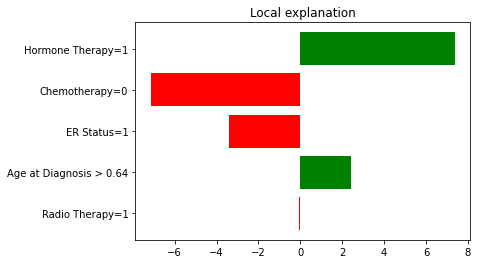

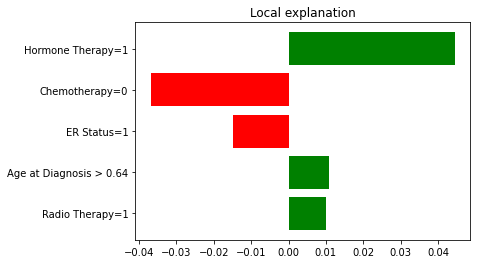

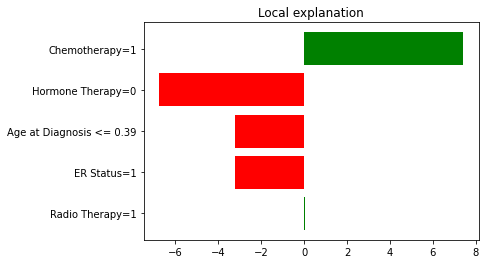

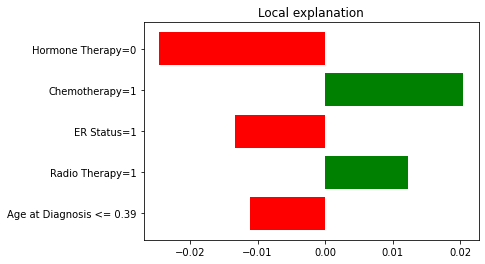

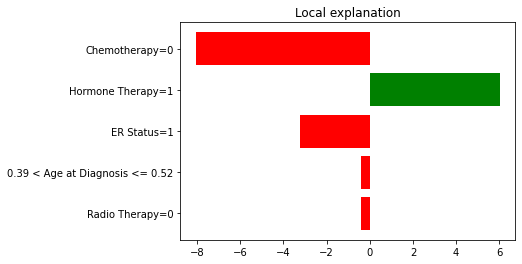

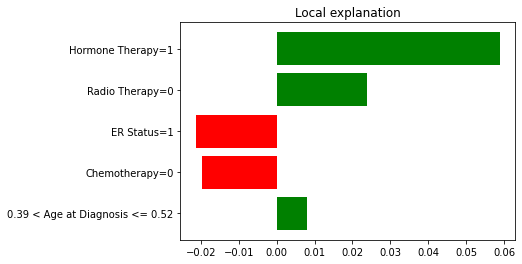

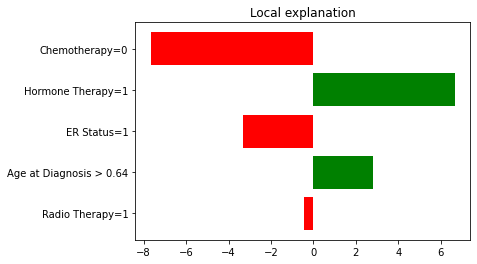

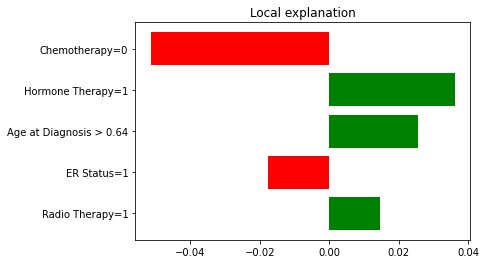

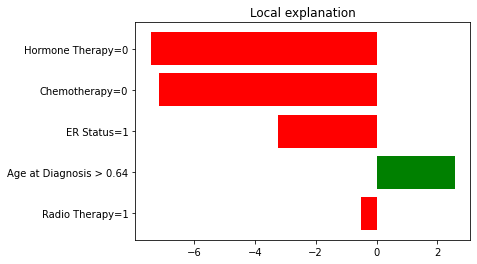

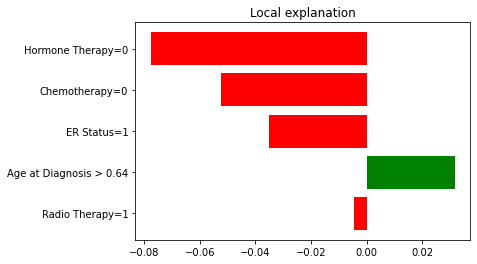

In [12]:
 #generate an explanation for testing on observed..
for i in range(5):
#use rf.predict_proba for classfication 
    exp = explainer.explain_instance(X_test[observed[i]], predict_fn,#num_features=13,
                                     model_regressor='non_Bay',
                                     num_samples=50)#'non_Bay' 'Bay_non_info_prior' 'Bay_info_prior'

    exp.show_in_notebook(show_table=True)

# fig = exp.as_pyplot_figure(label=1)

    exp = explainer.explain_instance(X_test[observed[i]], predict_fn,#num_features=13,
                                     model_regressor='Bay_non_info_prior',
                                     num_samples=50)#'non_Bay' 'Bay_non_info_prior' 'Bay_info_prior'

    exp.show_in_notebook(show_table=True)

    fig = exp.as_pyplot_figure(label=1)


    exp = explainer.explain_instance(X_test[observed[i]], predict_fn,#num_features=13,
                                     model_regressor='Bay_info_prior',
                                     num_samples=50)#'non_Bay' 'Bay_non_info_prior' 'Bay_info_prior'

    exp.show_in_notebook(show_table=True)

    fig = exp.as_pyplot_figure(label=1)

# exp = explainer.explain_instance(X_test[i], predict_fn,#num_features=13,
#                                   model_regressor='BayesianRidge_inf_prior_fit_alpha',
#                                   num_samples=50,
#                                   #labels=labels_test[i],
#                                 )
# #'non_Bay' 'Bay_non_info_prior' 'Bay_info_prior', 'BayesianRidge_inf_prior_fit_alpha'

# #now read the alpha, lambda from configuration files..
# alpha_init=1
# lambda_init=1
# with open('./data/posterior_configure.csv') as csv_file:
#     csv_reader=csv.reader(csv_file)
#     line_count = 0
#     for row in csv_reader:
#         if line_count == 1:
#             alpha_init=float(row[0])
#             lambda_init=float(row[1])
#         line_count=line_count+1



# exp=calculate_posteriors.get_posterior(exp,hyper_para_alpha=alpha_init, hyper_para_lambda=lambda_init,
#                                         label=1)



# exp.show_in_notebook(show_table=True)
# #print(exp.as_list())
# #fig = exp.as_pyplot_figure(label=1)